In [4]:
import numpy as np 
import matplotlib.pyplot as plt
from matplotlib import colors
import pandas as pd
import os
import math

In [5]:
parent_dir = os.path.dirname(os.getcwd())
# Path to the Density_profiles directory
density_profiles_dir = os.path.join(parent_dir, "Density_profiles")

# Count the number of files in the directory

def load_df(name,tag):
    name = os.path.join(parent_dir, "Density_profiles",tag, name)
    print("Reading file: ", name)
    df = pd.read_csv(name,delimiter = " ")

    extra=[]
    print(list(df.columns)[5])
    try:
        nperiod = (list(df.columns)[4])
        df.drop(columns=[nperiod],inplace=True)
        nperiod = int(nperiod)
        extra.append(nperiod)
    except:
        print("No nperiod")
    try:
        mu = (list(df.columns)[4])
        df.drop(columns=[mu],inplace=True), n_windows
    except:
        print("No mu")
    try:
        packing = (list(df.columns)[4])
        df.drop(columns=[packing],inplace=True)
        packing = float(packing)
        extra.append(packing)
    except:
        print("No packing")
    return df, extra

def load_df_lin(num,tag):
    name = "rho_MC_2D_seed"+str(num)+".dat"
    name = os.path.join(parent_dir, "Density_profiles",tag, name)
    df = pd.read_csv(name,delimiter = " ")
    nperiod = (list(df.columns)[-1])
    df.drop(columns=[nperiod],inplace=True)
    nperiod = int(nperiod)
    return df,nperiod

def sanity_check(df):
    rowslarge = df[df["rho"] > 2.0]
    rows0 = df[df["rho"] == 0.0]
    return rowslarge,rows0

def potential(x,nperiod,L,Amp):
    Lperiod = L/nperiod
    V = Amp*np.cos(2*np.pi*x/Lperiod)
    return V


### Old grainy data

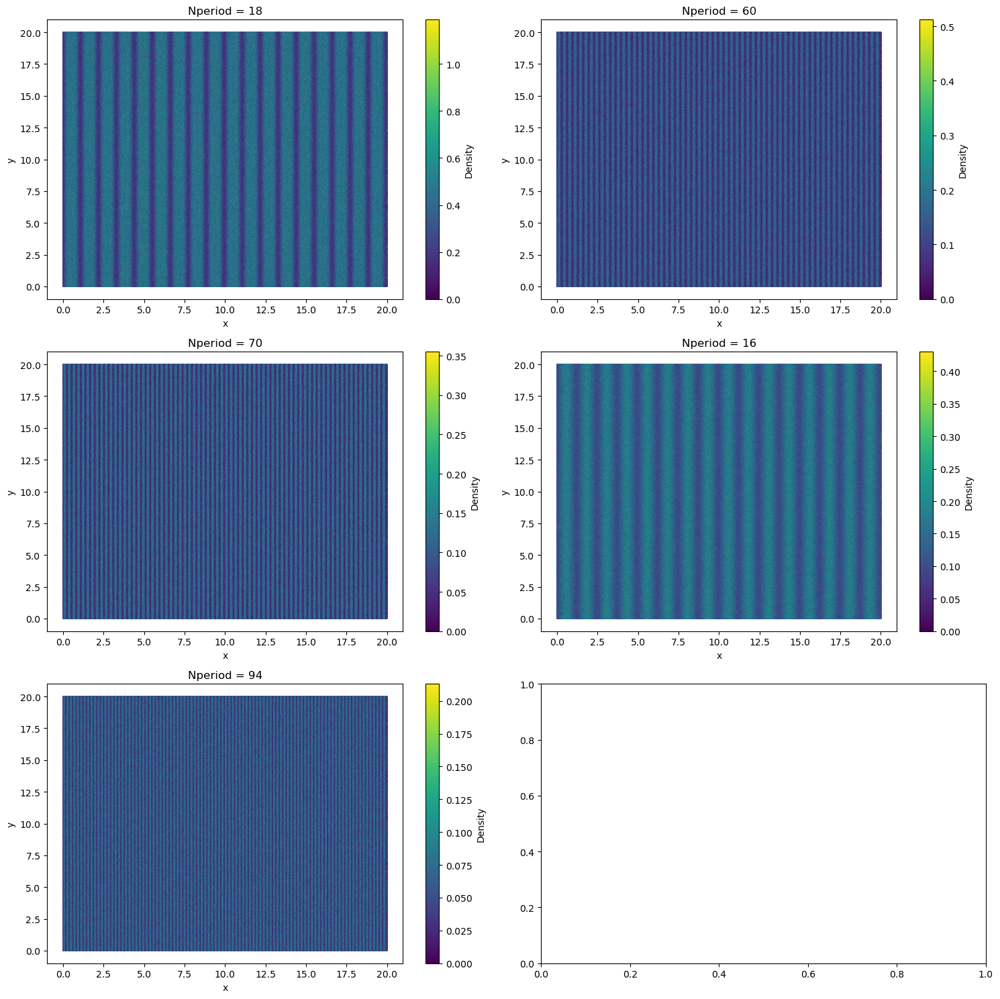

In [ ]:
tag = "parallel2025-05-05_18-02-50"
tag="test"
num = len([f for f in os.listdir(density_profiles_dir) if os.path.isfile(os.path.join(density_profiles_dir, f))])
num = 5
dataframes = {}
df,period = load_df(1,tag)
## calculate grid size for subplots (rows and cols)
rows = math.ceil(math.sqrt(num))
cols = math.ceil(num/rows)

## create subplots
fig, axs = plt.subplots(rows, cols, figsize=(15, 15))

for i in range(num):
    # Get the current dataframe
    df,period =load_df(i+1,tag)
    # Calculate the row and column index for the subplot
    row = i // cols
    col = i % cols
    
    # Plot the density profile
    axs[row, col].scatter(df["x"], df["y"], c=df["rho"], s=0.5)
    axs[row, col].set_title("Nperiod = "+str(period))
    axs[row, col].set_xlabel("x")
    axs[row, col].set_ylabel("y")
    fig.colorbar(axs[row, col].collections[0], ax=axs[row, col], label="Density")
plt.tight_layout()
plt.show()


fig, axs = plt.subplots(rows, cols, figsize=(15, 15))

for i in range(num):
    # Get the current dataframe
    df = load_df(i+1)[0]
    df = df.groupby("x").mean()
    df = df.reset_index()

    # Calculate the row and column index for the subplot
    row = i // cols
    col = i % cols
    
    # Plot the density profile
    axs[row, col].plot(df["x"], df["rho"])
    axs[row, col].set_title(f"Density profile {i+1}")
    axs[row, col].set_xlabel("x")
    axs[row, col].set_ylabel("rho")
plt.tight_layout()
plt.show()

### Check to fix parallel compute

/tmp/ipykernel_266781/679390961.py:7: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  N_df2 = pd.read_csv(os.path.join(path, "N.dat"),delimiter = "  ")


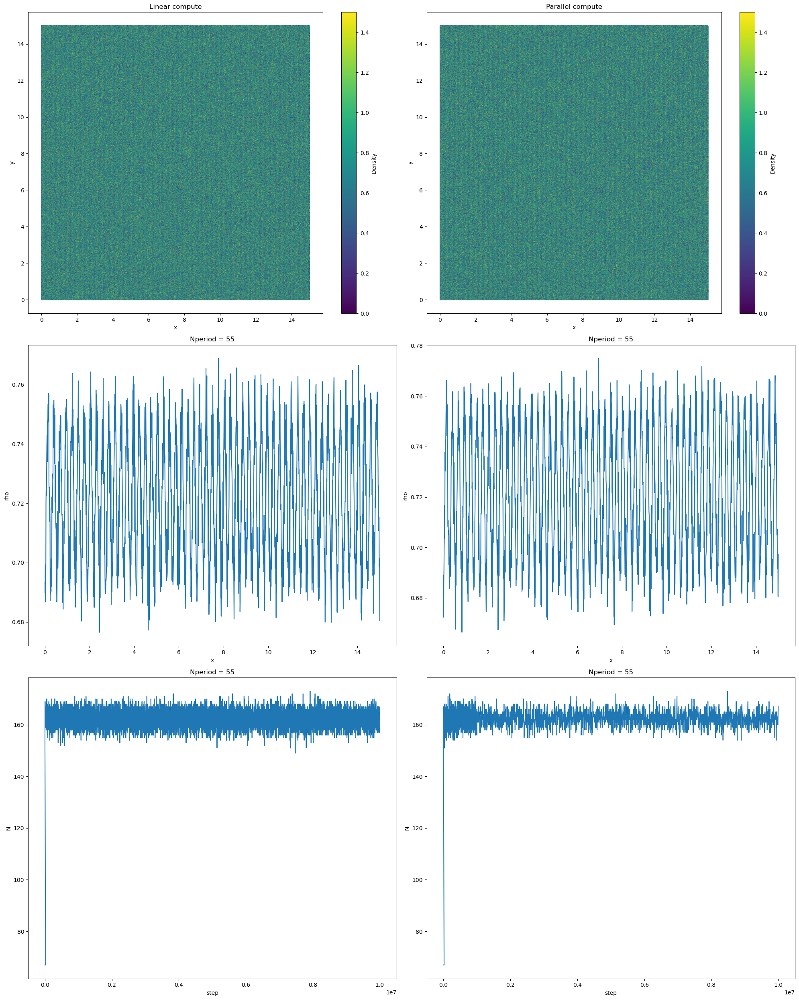

In [64]:
tag = "linear_compare"
tagpar =  "parallel2025-05-08_15-00-34"
path = "/home/hagen/Documents/master_project/Data_generation/Output/"
data_path = os.path.join(path, tagpar)

N_df = pd.read_csv(os.path.join(data_path, "N.dat"),delimiter = " ")
N_df2 = pd.read_csv(os.path.join(path, "N.dat"),delimiter = "  ")
dfp, periodp,mup = load_df(1,tagpar)
df, period = load_df_lin(1,tag)

fig,axs = plt.subplots(3, 2, figsize=(20, 25))
axs[0, 0].scatter(df["x"], df["y"], c=df["rho"], s=0.5,vmax=1.5)
axs[0, 0].set_title("Linear compute")
axs[0, 0].set_xlabel("x")
axs[0, 0].set_ylabel("y")
axs[0, 1].scatter(dfp["x"], dfp["y"], c=dfp["rho"], s=0.5,vmax=1.5)
axs[0, 1].set_title("Parallel compute")
axs[0, 1].set_xlabel("x")
axs[0, 1].set_ylabel("y")
axs[1, 0].plot(df.groupby("x").mean().reset_index()["x"], df.groupby("x").mean().reset_index()["rho"])
axs[1, 0].set_title("Nperiod = "+str(period))
axs[1, 0].set_xlabel("x")
axs[1, 0].set_ylabel("rho")
axs[1, 1].plot(dfp.groupby("x").mean().reset_index()["x"], dfp.groupby("x").mean().reset_index()["rho"])
axs[1, 1].set_title("Nperiod = "+str(periodp))
axs[1, 1].set_xlabel("x")
axs[1, 1].set_ylabel("rho")
axs[2, 0].plot(N_df["step"], N_df["N"], label="N")
axs[2, 1].plot(N_df2["step"], N_df2["N"], label="N2")
axs[2, 0].set_title("Nperiod = "+str(period))
axs[2, 1].set_title("Nperiod = "+str(periodp))
axs[2, 0].set_xlabel("step")
axs[2, 1].set_xlabel("step")
axs[2, 0].set_ylabel("N")
axs[2, 1].set_ylabel("N")
fig.colorbar(axs[0, 0].collections[0], ax=axs[0, 0], label="Density")
fig.colorbar(axs[0, 1].collections[0], ax=axs[0, 1], label="Density")
plt.tight_layout()
plt.show()


### Plots of first long run
- All are generated at Amp=3
- Noted artifacts in peaks
- These are still the data used to train the first versions of the network
    - until origin of artifacts are determined, exclude weird peaks from training data

#### Plots with potential

['rho_MC_2D_56.dat', 'rho_MC_2D_50.dat', 'rho_MC_2D_101.dat', 'rho_MC_2D_9.dat', 'rho_MC_2D_93.dat', 'rho_MC_2D_58.dat', 'rho_MC_2D_23.dat', 'rho_MC_2D_43.dat', 'rho_MC_2D_130.dat', 'rho_MC_2D_68.dat', 'rho_MC_2D_109.dat', 'rho_MC_2D_29.dat', 'rho_MC_2D_139.dat', 'rho_MC_2D_88.dat', 'rho_MC_2D_110.dat', 'rho_MC_2D_7.dat', 'rho_MC_2D_38.dat', 'rho_MC_2D_57.dat', 'rho_MC_2D_67.dat', 'rho_MC_2D_20.dat', 'rho_MC_2D_134.dat', 'rho_MC_2D_112.dat', 'rho_MC_2D_123.dat', 'rho_MC_2D_136.dat', 'rho_MC_2D_1.dat', 'rho_MC_2D_24.dat', 'rho_MC_2D_79.dat', 'rho_MC_2D_48.dat', 'rho_MC_2D_133.dat', 'rho_MC_2D_84.dat', 'rho_MC_2D_21.dat', 'rho_MC_2D_34.dat', 'rho_MC_2D_26.dat', 'rho_MC_2D_14.dat', 'rho_MC_2D_97.dat', 'rho_MC_2D_64.dat', 'rho_MC_2D_15.dat', 'rho_MC_2D_90.dat', 'rho_MC_2D_140.dat', 'rho_MC_2D_122.dat', 'rho_MC_2D_83.dat', 'rho_MC_2D_129.dat', 'rho_MC_2D_54.dat', 'rho_MC_2D_148.dat', 'rho_MC_2D_80.dat', 'rho_MC_2D_99.dat', 'rho_MC_2D_121.dat', 'rho_MC_2D_125.dat', 'rho_MC_2D_75.dat', 'rho_M

ValueError: not enough values to unpack (expected 3, got 2)

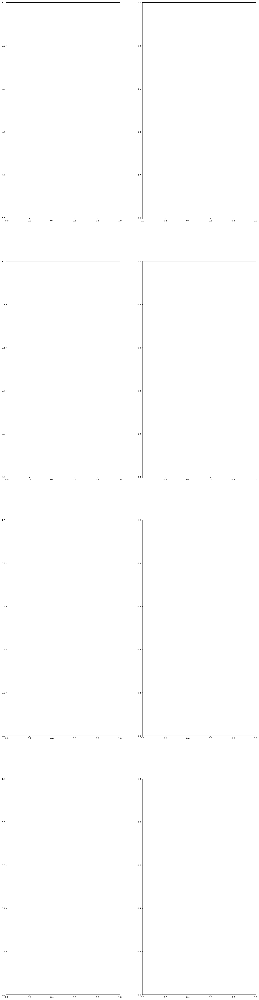

In [7]:
tag = "parallel2025-05-09_18-33-17"
num = 20 
density_profiles_dir = os.path.join(parent_dir, "Density_profiles",tag)
names= [f for f in os.listdir(density_profiles_dir) if os.path.isfile(os.path.join(density_profiles_dir, f))]
print(names)
num = len(names[36:40])
rows = 4
cols = 2

## create subplots
fig, axs = plt.subplots(rows, cols, figsize=(20,80))

for i,name in enumerate(names[36:40]):
    # Get the current dataframe
    df,period,mu =load_df(name,tag)
    # Calculate the row and column index for the subplot
    
    # Plot the density profile
    axs[i, 0].scatter(df["x"], df["y"], c=df["rho"], s=0.5)
    axs[i,0].set_title("Nperiod = "+str(period)+" mu = "+str(mu))
    axs[i,0].set_xlabel("x")
    axs[i,0].set_ylabel("y")
    axs[i, 1].plot(df.groupby("x").mean().reset_index()["x"], df.groupby("x").mean().reset_index()["rho"],label="rho")
    axs[i,1].plot(df.groupby("x").mean().reset_index()["x"], potential(df.groupby("x").mean().reset_index()["x"],period,15),label="potential")
    axs[i, 1].set_title("Nperiod = "+str(period))
    axs[i, 1].set_xlabel("x")
    axs[i, 1].set_ylabel("rho")
    axs[i, 1].legend()
    # axs[i, 2].scatter(df["x"], df["y"], c=np.log(df["rho"])+df["muloc"], s=0.5)
    # axs[i, 2].set_title("Nperiod = "+str(period))
    # axs[i, 2].set_xlabel("x")
    # axs[i, 2].set_ylabel("c1")


    fig.colorbar(axs[i, 0].collections[0], ax=axs[i, 0], label="Density")
plt.tight_layout()
plt.show()



#### Plot all, then exclude weird peaks

In [10]:
tag = "parallel2025-05-09_18-33-17"
num = 20 
density_profiles_dir = os.path.join(parent_dir, "Density_profiles",tag)
names= [f for f in os.listdir(density_profiles_dir) if os.path.isfile(os.path.join(density_profiles_dir, f))]
slice = names[6*num:]
rows = len(slice)
cols = 2

## create subplots
fig, axs = plt.subplots(rows, cols, figsize=(18,18*rows/2))
for i, name in enumerate(slice):
    # Get the current dataframe
    df, extra = load_df(name, tag)
    
    # Calculate the row and column index for the subplot
    period, mu  = extra[0], extra[1]

    shape = np.sqrt(len(df)).astype(int)
    xi = df["x"].values.reshape(shape, shape)
    yi = df["y"].values.reshape(shape,shape)
    rho = df["rho"].values.reshape(shape,shape)
    
    pcm = axs[i, 0].pcolormesh(xi, yi, rho, shading='auto', cmap='viridis')
    axs[i, 0].set_title(f"Nperiod = {period}, mu = {mu}")
    axs[i, 0].set_xlabel("x")
    axs[i, 0].set_ylabel("y")

    x_values = df.groupby("x").mean().reset_index()["x"]
    rho_values = df.groupby("x").mean().reset_index()["rho"]
    
    axs[i, 1].plot(x_values, rho_values, label="rho")
#    axs[i, 1].plot(x_values, potential(x_values, period, 15, 3), label="potential")
    axs[i, 1].set_title(name)
    axs[i, 1].set_xlabel("x")
    axs[i, 1].set_ylabel("rho")
    axs[i, 1].legend()

    fig.colorbar(pcm, ax=axs[i, 0], label="Density")
# ➡️ 4. One shared colorbar for all density plots

plt.tight_layout()
plt.savefig("density_profiles.png")
plt.close()


Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-09_18-33-17/rho_MC_2D_22.dat
5.01963
No packing
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-09_18-33-17/rho_MC_2D_30.dat
7.16978
No packing
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-09_18-33-17/rho_MC_2D_96.dat
2.75227
No packing
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-09_18-33-17/rho_MC_2D_10.dat
0.987612
No packing
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-09_18-33-17/rho_MC_2D_146.dat
4.94035
No packing
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-09_18-33-17/rho_MC_2D_138.dat
6.08577
No packing
Reading file:  /home/hagen/Documents/master_project/Pro

### Plots of second long run, packing fraction included
- Try to replicate artifacts, determine packing fraction
- Note: unsure of amplitude

['rho_MC_2D_9.dat', 'rho_MC_2D_8.dat', 'rho_MC_2D_23.dat', 'rho_MC_2D_43.dat', 'rho_MC_2D_29.dat', 'rho_MC_2D_7.dat', 'rho_MC_2D_38.dat', 'rho_MC_2D_32.dat', 'rho_MC_2D_20.dat', 'rho_MC_2D_1.dat', 'rho_MC_2D_24.dat', 'rho_MC_2D_48.dat', 'rho_MC_2D_21.dat', 'rho_MC_2D_34.dat', 'rho_MC_2D_26.dat', 'rho_MC_2D_14.dat', 'rho_MC_2D_15.dat', 'rho_MC_2D_18.dat', 'rho_MC_2D_6.dat', 'rho_MC_2D_42.dat', 'rho_MC_2D_13.dat', 'rho_MC_2D_41.dat', 'rho_MC_2D_44.dat', 'rho_MC_2D_49.dat', 'rho_MC_2D_35.dat', 'rho_MC_2D_19.dat', 'rho_MC_2D_17.dat', 'rho_MC_2D_28.dat', 'rho_MC_2D_16.dat', 'rho_MC_2D_5.dat', 'rho_MC_2D_47.dat', 'rho_MC_2D_36.dat', 'rho_MC_2D_31.dat', 'rho_MC_2D_40.dat', 'rho_MC_2D_11.dat', 'rho_MC_2D_37.dat', 'rho_MC_2D_4.dat', 'rho_MC_2D_27.dat', 'rho_MC_2D_3.dat', 'rho_MC_2D_45.dat', 'rho_MC_2D_2.dat', 'rho_MC_2D_12.dat', 'rho_MC_2D_33.dat', 'rho_MC_2D_25.dat', 'rho_MC_2D_22.dat', 'rho_MC_2D_30.dat', 'rho_MC_2D_10.dat', 'rho_MC_2D_39.dat', 'rho_MC_2D_46.dat']
Reading file:  /home/hagen/D

IndexError: list index out of range

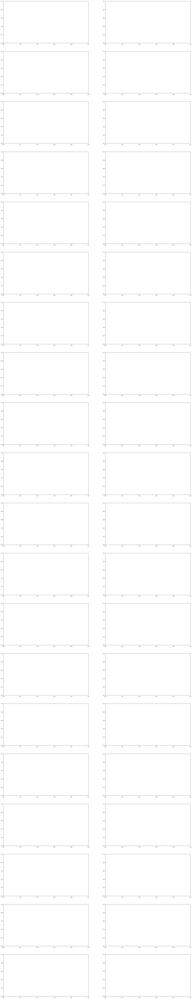

In [3]:
tag = "parallel2025-05-12_20-12-04"
num = 20 
density_profiles_dir = os.path.join(parent_dir, "Density_profiles",tag)
names= [f for f in os.listdir(density_profiles_dir) if os.path.isfile(os.path.join(density_profiles_dir, f))]
print(names)
rows = num
cols = 2

fig, axs = plt.subplots(rows, cols, figsize=(30, 160))

# Preload DataFrames and groupby results
for i, name in enumerate(names[:num]):
    # Get the current dataframe
    df, extra = load_df(name, tag)
    
    # Calculate the row and column index for the subplot
    period, mu, packing = extra[0], extra[1], extra[2]

    # ➡️ 1. Use `pcolormesh` instead of `scatter` for faster grid rendering
    shape = np.sqrt(len(df)).astype(int)
    xi = df["x"].values.reshape(shape, shape)
    yi = df["y"].values.reshape(shape,shape)
    rho = df["rho"].values.reshape(shape,shape)
    
    pcm = axs[i, 0].pcolormesh(xi, yi, rho, shading='auto', cmap='viridis')
    axs[i, 0].set_title(f"Nperiod = {period}, mu = {mu}, packing = {packing}")
    axs[i, 0].set_xlabel("x")
    axs[i, 0].set_ylabel("y")
    # ➡️ 2. Perform tag = "parallel2025-05-09_18-33-17"
    axs[i, 1].plot(x_values, rho_values, label="rho")
#    axs[i, 1].plot(x_values, potential(x_values, period, 15, 3), label="potential")
    axs[i, 1].set_title(f"Nperiod = {period}")
    axs[i, 1].set_xlabel("x")
    axs[i, 1].set_ylabel("rho")
    axs[i, 1].legend()

    fig.colorbar(pcm, ax=axs[i, 0], label="Density")
# ➡️ 4. One shared colorbar for all density plots

plt.tight_layout()
plt.show()

Reading file:  /home/hagen/Documents/master_project/Data_generation/Density_profiles/parallel2025-05-12_20-12-04/rho_MC_2D_9.dat
1.64461


AttributeError: 'LinearSegmentedColormap' object has no attribute 'colors'

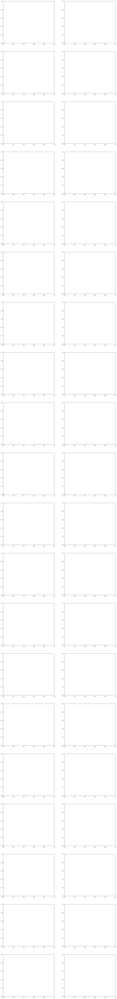

In [ ]:

# Define grid layout
fig, axs = plt.subplots(rows, cols, figsize=(18, 160))
viridis =colors.LinearSegmentedColormap.from_list("viridis",plt.cm.viridis.colors)
# Loop through each DataFrame
for i, name in enumerate(names[:num]):
    # Get the current dataframe
    df, extra = load_df(name, tag)

    shape = np.sqrt(len(df)).astype(int)
    # ➡️ 1. Datashader canvas
    canvas = ds.Canvas(plot_width=shape, plot_height=shape)
    
    # ➡️ 2. Aggregate density on the canvas
    agg = canvas.points(df, 'x', 'y', agg=ds.mean('rho'))
    
    # ➡️ 3. Transform aggregation to an image (faster than scatter)
    img = ds.transfer_functions.shade(agg,cmap=list(viridis.colors), how='linear', min_alpha=0, max_alpha=1)
    
    # ➡️ 4. Plot the rasterized image directly
    pcm=axs[i, 0].imshow(img.to_pil(), origin='lower')
    axs[i, 0].set_title(f"Nperiod = {extra[0]}, mu = {extra[1]}, packing = {extra[2]}")
    axs[i, 0].set_xlabel("x")
    axs[i, 0].set_ylabel("y")
    
    # ➡️ 5. Compute line plots for the second column
    df_grouped = df.groupby("x").mean().reset_index()
    x_values = df_grouped["x"]
    rho_values = df_grouped["rho"]
    
    axs[i, 1].plot(x_values, rho_values, label="rho")
    axs[i, 1].plot(x_values, potential(x_values, extra[0], 15, 3), label="potential")
    axs[i, 1].set_title(f"Nperiod = {extra[0]}")
    axs[i, 1].set_xlabel("x")
    axs[i, 1].set_ylabel("rho")
    axs[i, 1].legend()
    fig.colorbar(pcm, ax=axs[i, 0], label="Density")
plt.tight_layout()
plt.show()

### New data lower res

Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-16_18-08-55/rho_MC_2D_9.dat
1.64461
No mu
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-16_18-08-55/rho_MC_2D_8.dat
-1.88886
No mu
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-16_18-08-55/rho_MC_2D_7.dat
0.273391
No mu
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-16_18-08-55/rho_MC_2D_1.dat
7.97185
No mu
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-16_18-08-55/rho_MC_2D_14.dat
7.21893
No mu
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profiles/parallel2025-05-16_18-08-55/rho_MC_2D_15.dat
6.1358
No mu
Reading file:  /home/hagen/Documents/master_project/Project/Data_generation/Density_profile

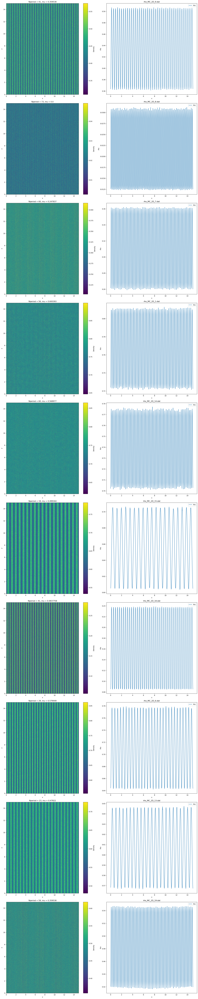

In [6]:
tag = "parallel2025-05-16_18-08-55"
num = 10 
density_profiles_dir = os.path.join(parent_dir, "Density_profiles",tag)
names= [f for f in os.listdir(density_profiles_dir) if os.path.isfile(os.path.join(density_profiles_dir, f))]
slice = names[:num]
rows = len(slice)
cols = 2

## create subplots
fig, axs = plt.subplots(rows, cols, figsize=(18,18*rows/2))
for i, name in enumerate(slice):
    # Get the current dataframe
    df, extra = load_df(name, tag)
    
    # Calculate the row and column index for the subplot
    period, mu  = extra[0], extra[1]

    shape = np.sqrt(len(df)).astype(int)
    xi = df["x"].values.reshape(shape, shape)
    yi = df["y"].values.reshape(shape,shape)
    rho = df["rho"].values.reshape(shape,shape)
    
    pcm = axs[i, 0].pcolormesh(xi, yi, rho, shading='auto', cmap='viridis')
    axs[i, 0].set_title(f"Nperiod = {period}, mu = {mu}")
    axs[i, 0].set_xlabel("x")
    axs[i, 0].set_ylabel("y")

    x_values = df.groupby("x").mean().reset_index()["x"]
    rho_values = df.groupby("x").mean().reset_index()["rho"]
    
    axs[i, 1].plot(x_values, rho_values, label="rho")
#    axs[i, 1].plot(x_values, potential(x_values, period, 15, 3), label="potential")
    axs[i, 1].set_title(name)
    axs[i, 1].set_xlabel("x")
    axs[i, 1].set_ylabel("rho")
    axs[i, 1].legend()

    fig.colorbar(pcm, ax=axs[i, 0], label="Density")
# ➡️ 4. One shared colorbar for all density plots

plt.tight_layout()